#### Import Libraries

In [21]:
import os
import pandas as pd
import geopandas as gpd
import contextily as ctx

import matplotlib.pyplot as plt
import seaborn as sns

import imageio.v2 as imageio
import glob

#### Settings

In [2]:
# Matplotlib 한글폰트 적용
# 정상적으로 적용될 경우도 있고, 안되는 경우도 있음.
import platform
import matplotlib.font_manager as fm

os_name = platform.system()
font_path = 'c:/Windows/Fonts/malgun.ttf' if os_name=='Windows' \
    else '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'
font_family = fm.FontProperties(fname=font_path).get_name()
plt.rcParams['font.family'] = font_family

# Matplotlib x,y축 레이블이 마이너스 일 때, '-'로 표시하도록 설정
plt.rcParams['axes.unicode_minus'] = False

# 레티나 디스플레이 적용(화질 성능 개선)
%config InlineBackend.figure_format = 'retina'

# Seaborn 기본 스타일 적용
sns.set_style('darkgrid')

In [3]:
# 폰트캐시까지 삭제 후 한글폰트가 사용될 수 있도록 캐시 삭제
# --> 이렇게 해야 비로소 한글이 표현되는 경우가 많음
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = [font_family]

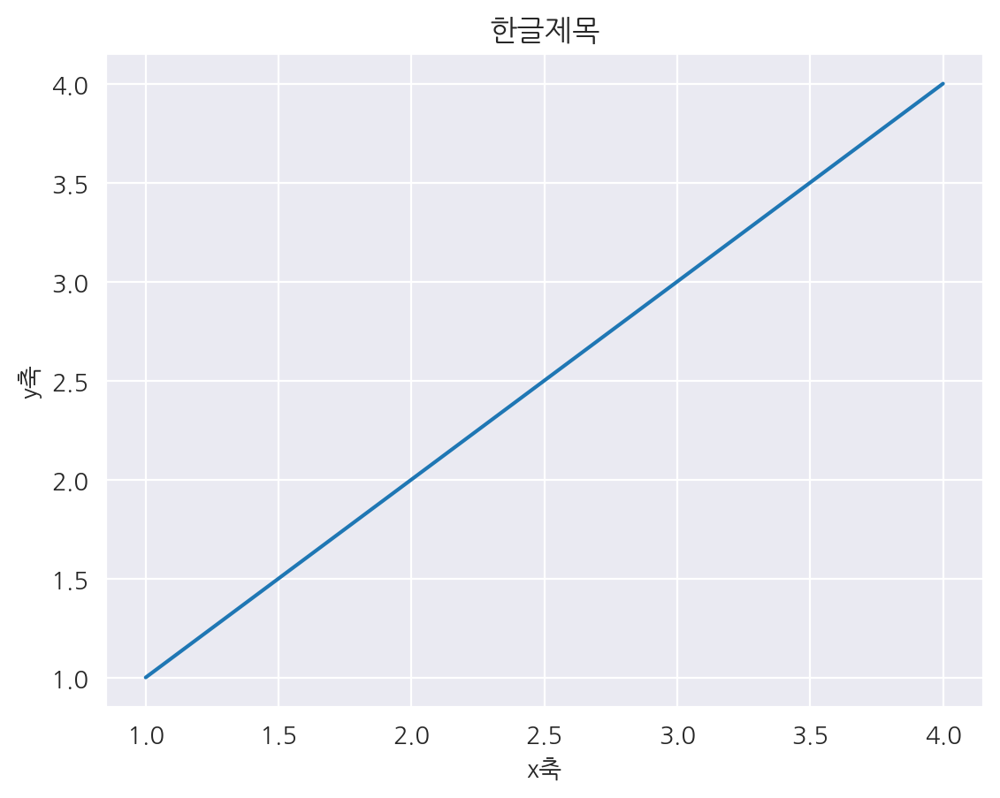

In [4]:
x_data, y_data = [1,2,3,4], [1,2,3,4]
plt.plot(x_data, y_data)
plt.xlabel('x축')
plt.ylabel('y축')
plt.title('한글제목')
plt.show()

#### Fetching Data

##### CCTV Info in Seoul [SHP]

In [5]:
CCTV_SHP_PATH = os.path.join(
    os.getcwd(), '89_data', 'shp', 'gdf_cctv_sl03.shp'
)

cctv_gdf = gpd.read_file(CCTV_SHP_PATH, encoding='utf-8')
cctv_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 7000 entries, 0 to 6999
Data columns (total 20 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   admin_nm    7000 non-null   object  
 1   addr_rd     6683 non-null   object  
 2   addr_jb     6346 non-null   object  
 3   purpose     7000 non-null   object  
 4   cctv_cnt    7000 non-null   object  
 5   pixel       5835 non-null   object  
 6   direction   4107 non-null   object  
 7   period      6554 non-null   object  
 8   date_insta  6219 non-null   object  
 9   tel         7000 non-null   object  
 10  lat         7000 non-null   float64 
 11  lon         7000 non-null   float64 
 12  date_make   7000 non-null   object  
 13  offer_admi  7000 non-null   object  
 14  offer_ad_1  7000 non-null   object  
 15  sl          7000 non-null   int64   
 16  zscore_lon  7000 non-null   float64 
 17  outliers    7000 non-null   int64   
 18  zscore_lat  7000 non-null   float64 
 19

#### Data Preprocessing

##### Coordinate Transformation: 4326 --> 3857
* 3857좌표계: 주로 `웹맵서비스`에서 사용하며, 원뿔 투영의 하나인 `메르카토르 프로젝션`을 기반으로 함
  * 웹 맵 서비스와 연동할 때 더 빠르고 효율적인 데이터 전송 및 렌더링이 가능하고, 거리 및 면적 계산등의 작업에서도 편리하게 사용됨

In [6]:
cctv_gdf_3857 = cctv_gdf.to_crs(epsg=3857)

##### Append 'x', 'y' Columns Using Geometry Info

In [7]:
cctv_gdf_3857['x'], cctv_gdf_3857['y'] = cctv_gdf_3857.geometry.x, cctv_gdf_3857.geometry.y
cctv_gdf_3857.head()

,admin_nm,addr_rd,addr_jb,purpose,cctv_cnt,pixel,direction,period,date_insta,tel,...,date_make,offer_admi,offer_ad_1,sl,zscore_lon,outliers,zscore_lat,geometry,x,y
0,서울특별시 영등포구,"선유로13길 25,서울영문초등학교 사거리앞",선유로13길 25,생활방범,3,NaN,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.348028,0,-0.950876,POINT (14124991.821 4511747.327),1.412499e+07,4.511747e+06
1,서울특별시 영등포구,"문래로4길 4,현대2차APT 202동 옆 서부간선도로 사잇길 육교앞",문래로4길 4,생활방범,2,NaN,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.406838,0,-0.937394,POINT (14124451.882 4511863.040),1.412445e+07,4.511863e+06
2,서울특별시 영등포구,"선유로9나길 22,사거리앞",문래동5가 12 사거리앞,생활방범,3,NaN,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.358297,0,-1.007738,POINT (14124897.547 4511259.295),1.412490e+07,4.511259e+06
3,서울특별시 영등포구,경인로94길 9-13,문래동1가 2-6,생활방범,3,NaN,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.145901,0,-1.030685,POINT (14126847.579 4511062.359),1.412685e+07,4.511062e+06
4,서울특별시 영등포구,"선유서로 31,현대6차APT 602동 근처 창대교회 사거리앞",문래동6가 55-1 현대6차APT 602동 근처 창대감리교회 사거리앞,생활방범,1,NaN,360도 전방면,30,2018-08,02-2670-4067,...,2020-05-06,3180000,서울특별시 영등포구,0,-1.392190,0,-0.957706,POINT (14124586.369 4511688.705),1.412459e+07,4.511689e+06


#### Display Map

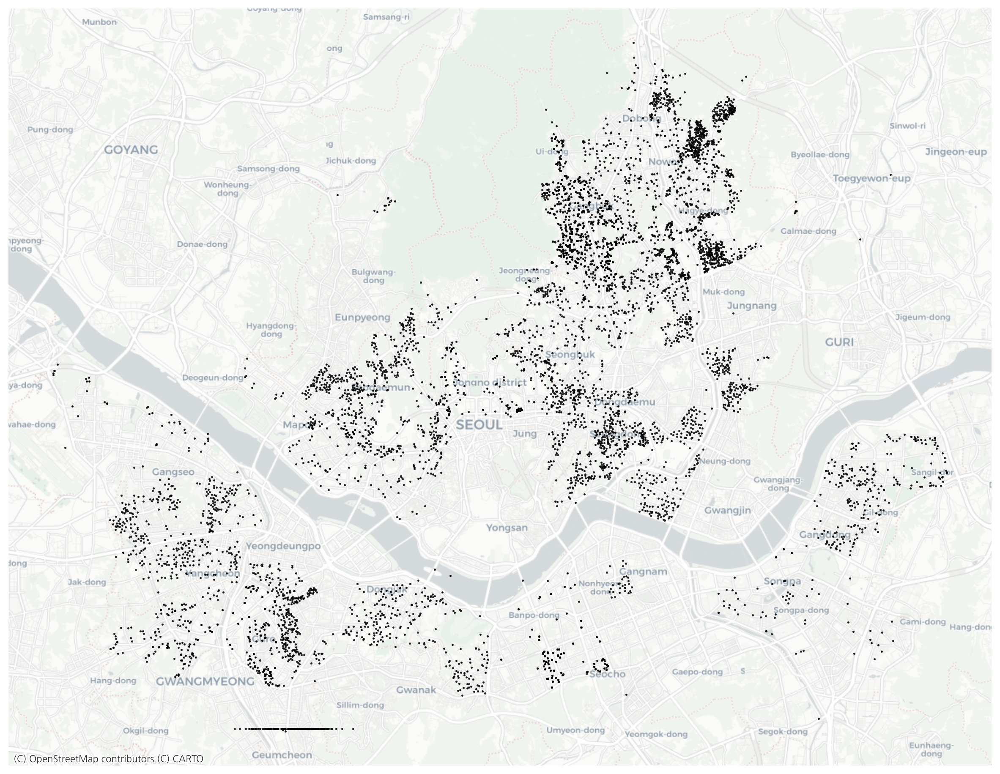

In [8]:
ax = cctv_gdf_3857.plot(
    figsize=(15,15), color='black', alpha=0.8, markersize=0.7
)
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)
ax.set_axis_off()
plt.show()

#### Animation Heatmap

##### Data Preprocessing

* Drop Rows with NaN Walues in Column 'date_insta'

In [9]:
cctv_gdf_3857.date_insta.unique()

array(['2018-08', '2018-10', '2013-11', '2015-09', '2010-12', '2011-02',
       '2013-01', '2013-09', '2006-01', '2016-10', '2015-12', '2018-06',
       '2017-01', '2011-09', '2010-11', '2011-01', '2012-06', '2014-01',
       '2016-09', '2017-02', '2017-08', '2017-09', '2018-11', '2012-01',
       '2012-11', '2012-07', '2011-11', '2013-12', '2009-01', '2009-06',
       '2013-07', '2014-12', '2012-09', '2018-12', '2011-12', '2005-01',
       '2006-02', '2015-03', '2007-01', '2010-01', '2015-04', '2020-11',
       '2020-09', '2020-05', '2020-04', '2020-01', '2020-12', '2014-08',
       '2014-05', '2014-10', '2014-11', '2015-01', nan, '2019-12',
       '2019-11', '2019-03', '2019-07', '2019-08', '2019-02', '2006-12',
       '2008-12', '2009-12', '2012-12', '2016-12', '2017-12', '2003-09',
       '2009-09', '2006-09', '2004-09', '2010-09', '2005-09', '2008-09',
       '2007-09', '2019-09', '2013-10', '2013-06', '2013-08', '2007-12',
       '2018-05', '2012-04', '2011-06', '1905-07', '2015-

In [10]:
cctv_gdf_3857.dropna(subset=['date_insta'], axis=0, inplace=True)

In [11]:
cctv_gdf_3857.date_insta.unique()

array(['2018-08', '2018-10', '2013-11', '2015-09', '2010-12', '2011-02',
       '2013-01', '2013-09', '2006-01', '2016-10', '2015-12', '2018-06',
       '2017-01', '2011-09', '2010-11', '2011-01', '2012-06', '2014-01',
       '2016-09', '2017-02', '2017-08', '2017-09', '2018-11', '2012-01',
       '2012-11', '2012-07', '2011-11', '2013-12', '2009-01', '2009-06',
       '2013-07', '2014-12', '2012-09', '2018-12', '2011-12', '2005-01',
       '2006-02', '2015-03', '2007-01', '2010-01', '2015-04', '2020-11',
       '2020-09', '2020-05', '2020-04', '2020-01', '2020-12', '2014-08',
       '2014-05', '2014-10', '2014-11', '2015-01', '2019-12', '2019-11',
       '2019-03', '2019-07', '2019-08', '2019-02', '2006-12', '2008-12',
       '2009-12', '2012-12', '2016-12', '2017-12', '2003-09', '2009-09',
       '2006-09', '2004-09', '2010-09', '2005-09', '2008-09', '2007-09',
       '2019-09', '2013-10', '2013-06', '2013-08', '2007-12', '2018-05',
       '2012-04', '2011-06', '1905-07', '2015-02', 

In [12]:
cctv_gdf_3857.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 6219 entries, 0 to 6942
Data columns (total 22 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   admin_nm    6219 non-null   object  
 1   addr_rd     6044 non-null   object  
 2   addr_jb     5786 non-null   object  
 3   purpose     6219 non-null   object  
 4   cctv_cnt    6219 non-null   object  
 5   pixel       5330 non-null   object  
 6   direction   3686 non-null   object  
 7   period      6029 non-null   object  
 8   date_insta  6219 non-null   object  
 9   tel         6219 non-null   object  
 10  lat         6219 non-null   float64 
 11  lon         6219 non-null   float64 
 12  date_make   6219 non-null   object  
 13  offer_admi  6219 non-null   object  
 14  offer_ad_1  6219 non-null   object  
 15  sl          6219 non-null   int64   
 16  zscore_lon  6219 non-null   float64 
 17  outliers    6219 non-null   int64   
 18  zscore_lat  6219 non-null   float64 
 19  geo

* Adding `year_install` using Column `date_insta`

In [13]:
cctv_gdf_3857['year_install'] = cctv_gdf_3857['date_insta'].str[:4]
# 정수형으로 변환
cctv_gdf_3857.year_install = cctv_gdf_3857.year_install.astype(int)

##### Save Images by Year

In [14]:
_temp_unique_years = cctv_gdf_3857.year_install.unique()
_temp_unique_years.sort()
_temp_unique_years

array([1905, 2003, 2004, 2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012,
       2013, 2014, 2015, 2016, 2017, 2018, 2019, 2020, 2022])

In [27]:
SAVE_PATH = os.path.join(
    os.getcwd(), '89_data', 'result', '17_animations'
)
def make_heatmap_image(year):
    plt.figure(figsize=(15,15))
    lvl = ctx.Place('Seoul', source=ctx.providers.Stamen.TonerLite)
    ax = sns.kdeplot(
        data=cctv_gdf_3857[cctv_gdf_3857.year_install == year],
        x='x', y='y',
        cmap='Purples', alpha=0.7, fill=True
    )
    lvl.plot(ax)
    ax.set_axis_off()
    plt.title(f'CCTV Heatmap, {year}년', fontsize=18)
    save_file = os.path.join(SAVE_PATH, f'heatmap_{year}.png')
    plt.savefig(save_file, bbox_inches='tight', pad_inches=0.01)
    plt.show()

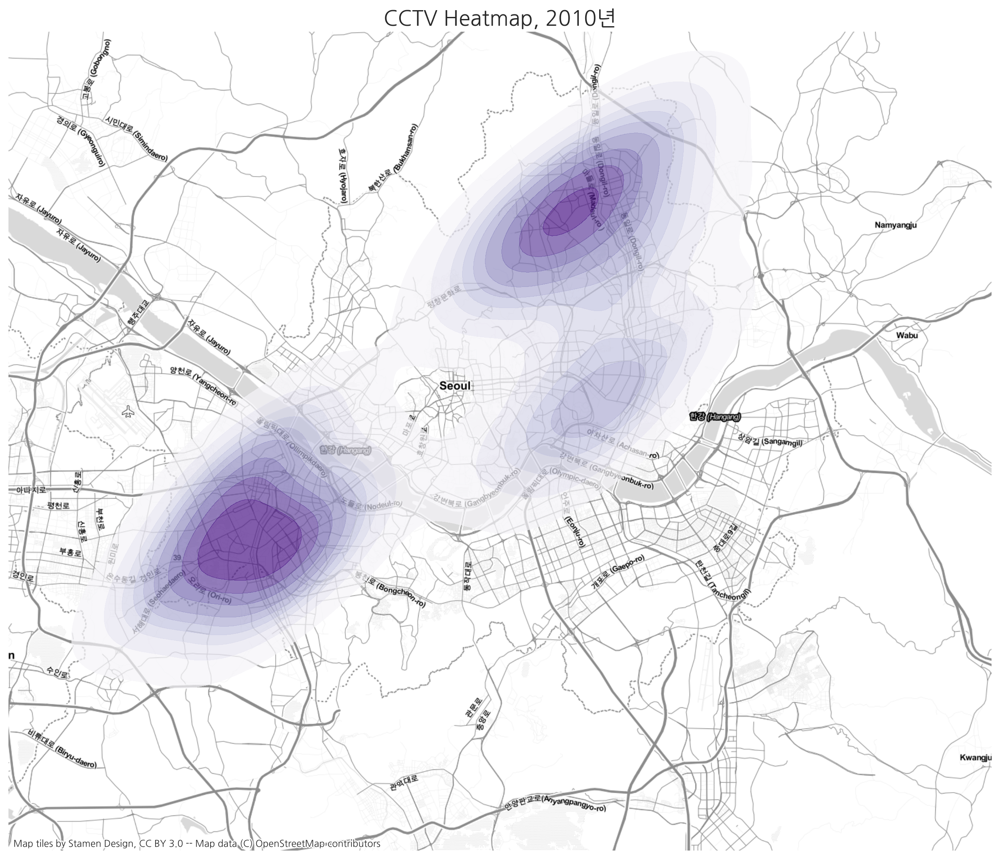

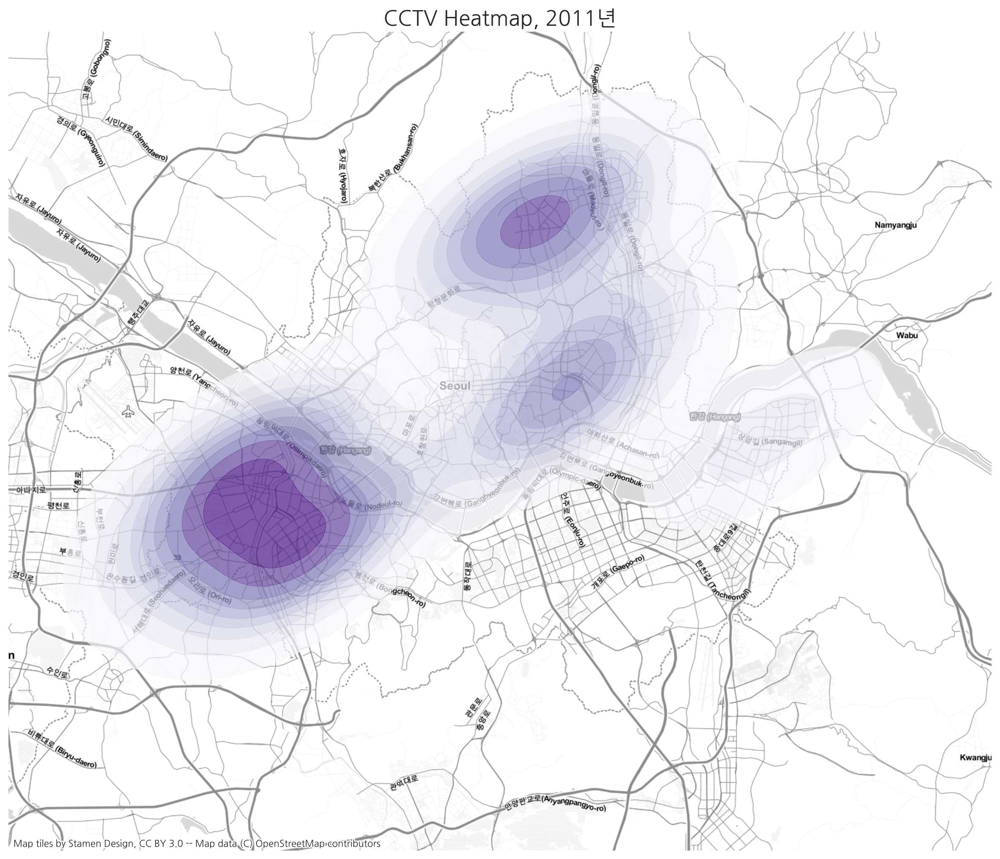

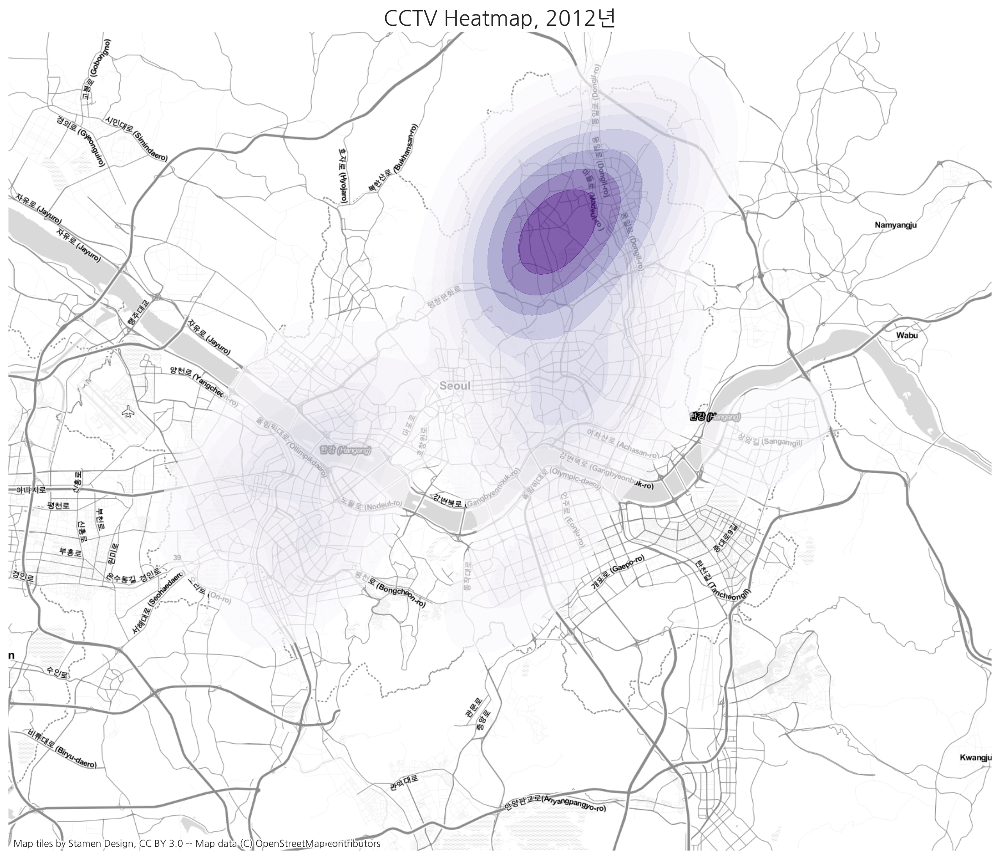

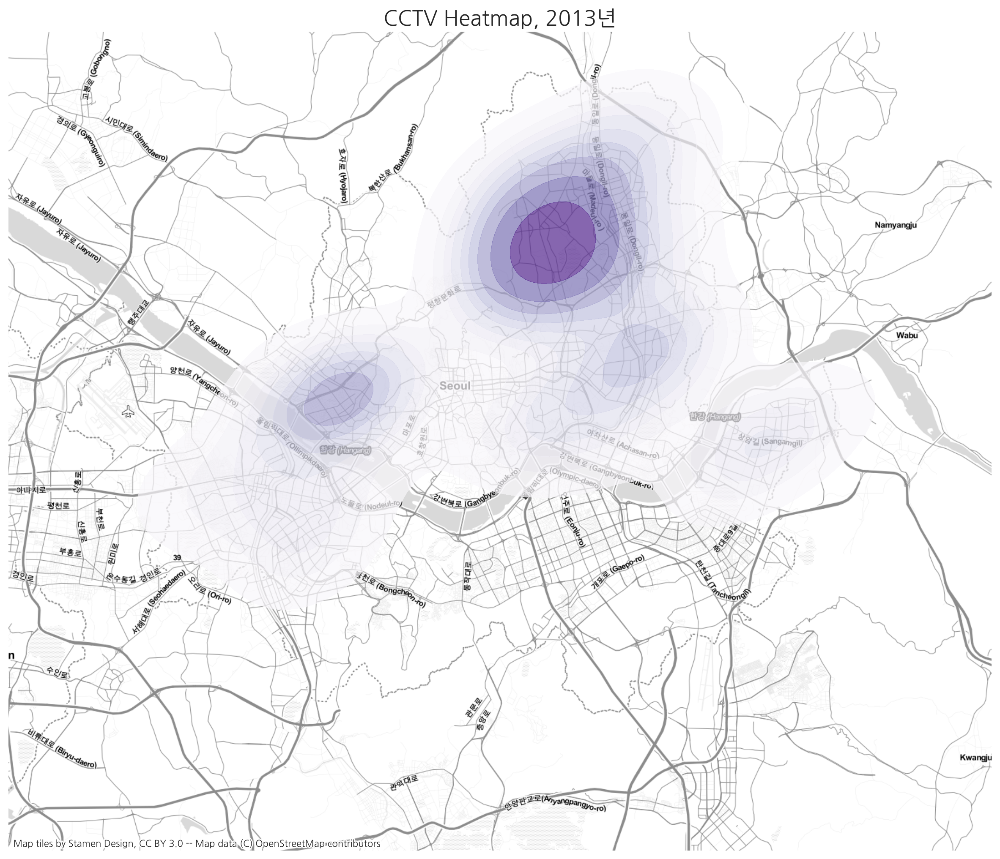

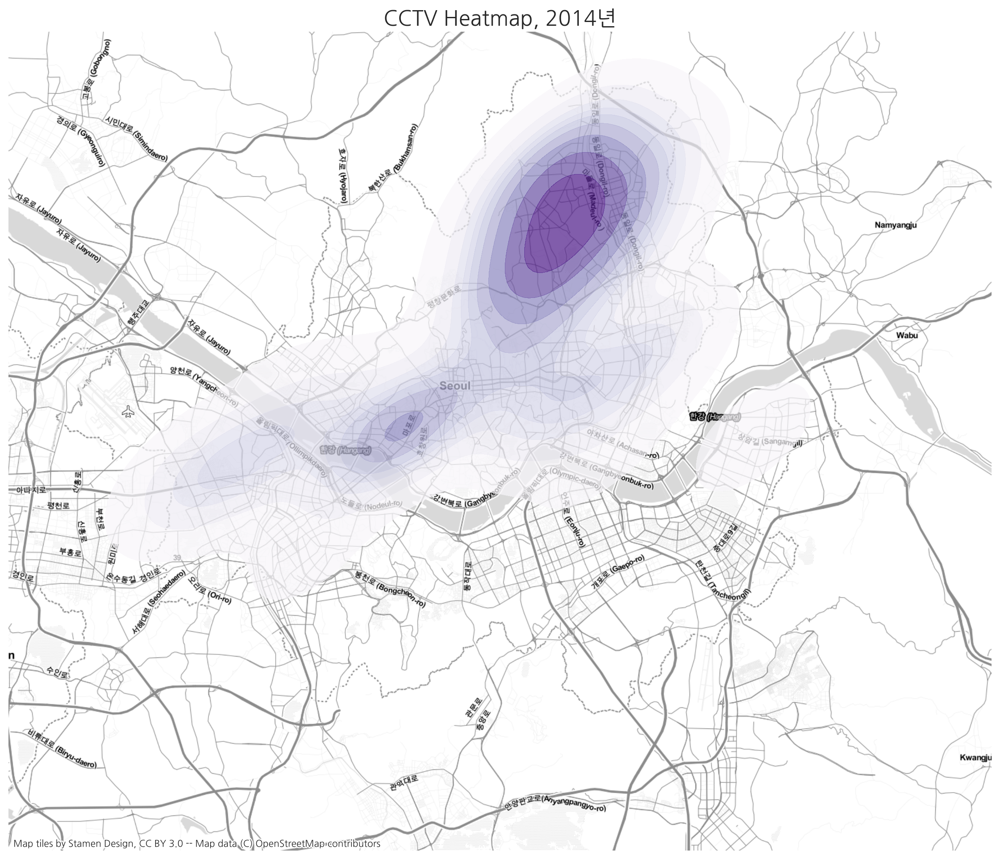

...

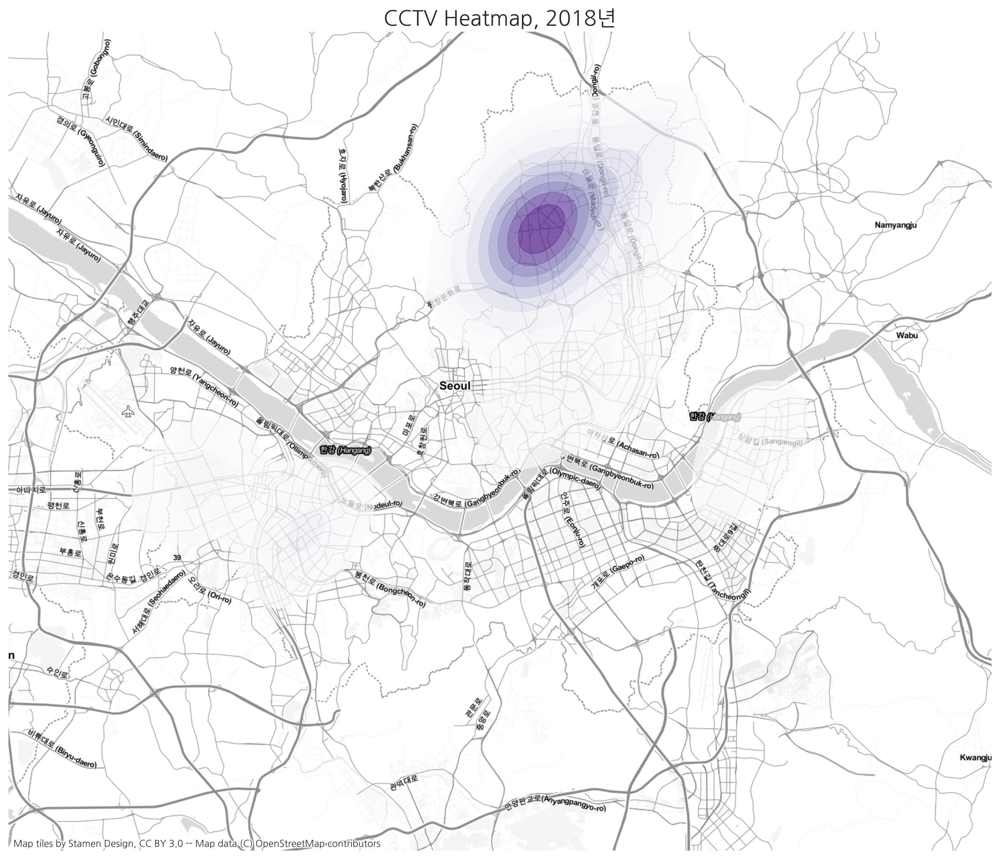

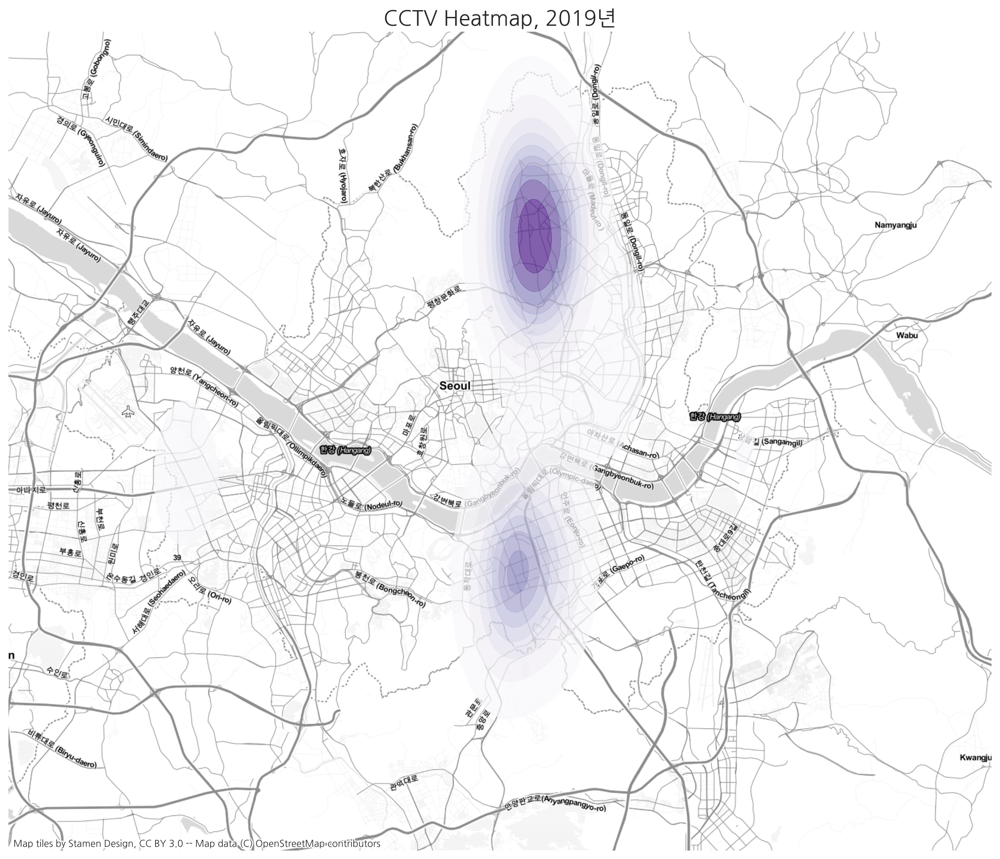

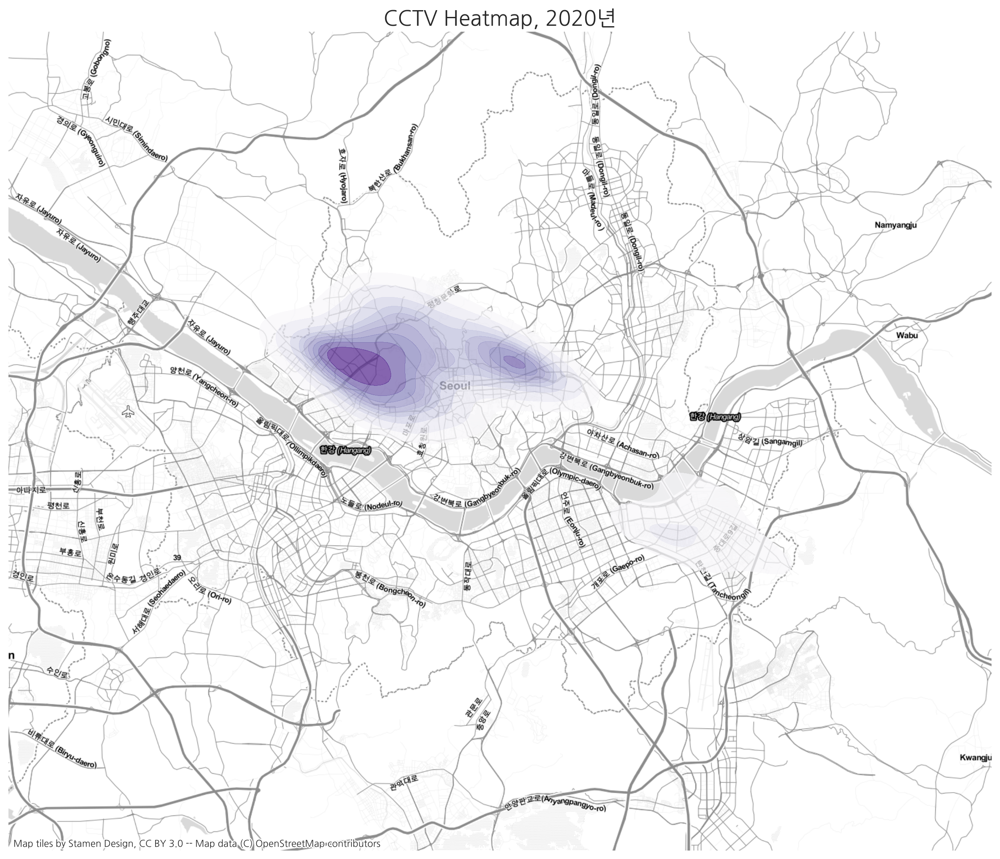

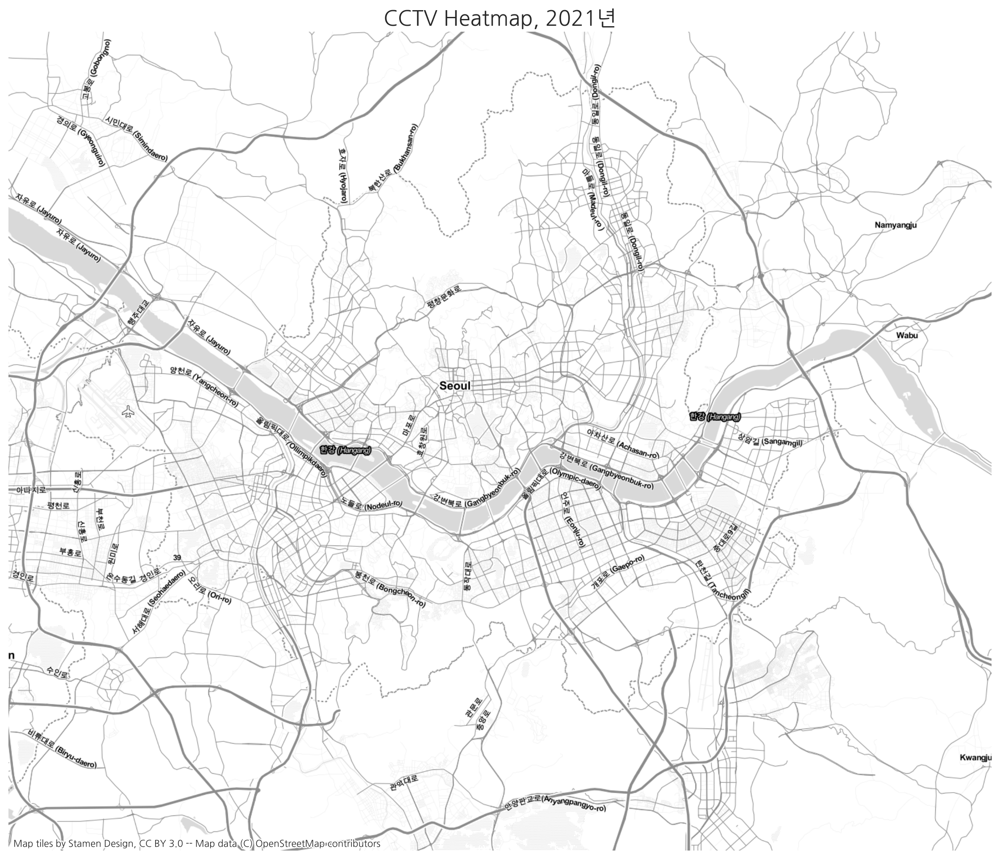

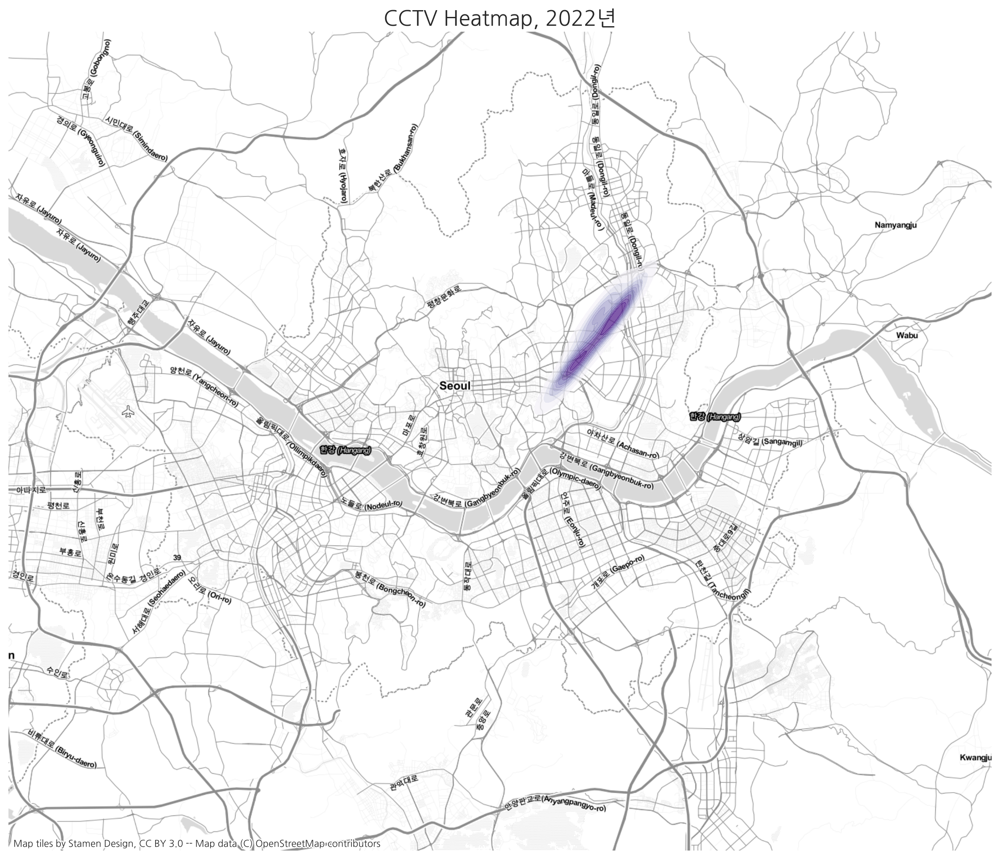

In [28]:
# 2010년부터 2022년까지 이미지파일 생성
for year in range(2010, 2023):
    make_heatmap_image(year)

##### Create Animation

In [31]:
images = glob.glob(os.path.join(SAVE_PATH, '*.png'))
# images = [file for file in os.listdir(SAVE_PATH) if file.endswith('.png')]
# 년도별 정렬
images.sort()

frames = [imageio.imread(image) for image in images]

In [32]:
SAVE_FILE_PATH = os.path.join(SAVE_PATH, 'cctv_heatmap_animation.gif')
# loop=0: 무한반복
imageio.mimsave(SAVE_FILE_PATH, frames, duration=1500, loop=0)

#### Reference: Seaborn & Kdeplot
* https://seaborn.pydata.org/generated/seaborn.kdeplot.html